In [33]:
!pip install opendatasets --quiet

In [34]:
import os
import opendatasets as od
import torch
import torchvision  

In [35]:
dataset_url='https://www.kaggle.com/datasets/bryanb/abstract-art-gallery'
od.download(dataset_url)

Skipping, found downloaded files in "./abstract-art-gallery" (use force=True to force download)


In [36]:
data_dir='./abstract-art-gallery'
train_dir=(data_dir+'/Abstract_gallery')
val_dir=(data_dir+'/Abstract_gallery_2')

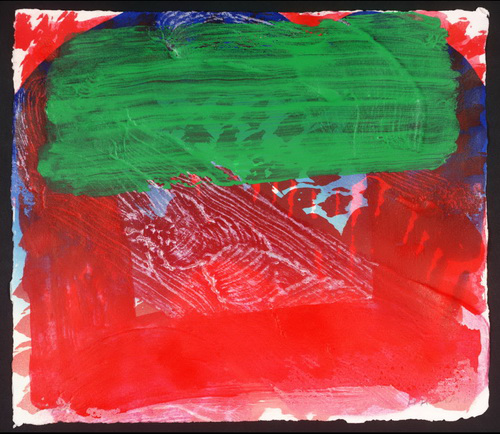

In [37]:
import matplotlib.pyplot as plt
from PIL import Image
Image.open(train_dir+'/Abstract_gallery/Abstract_image_1000.jpg')

In [38]:
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as T

In [39]:
image_size=128
batch_size=128
stats=((0.5,0.5,0.5),(0.5,0.5,0.5))

In [40]:
train_ds=ImageFolder(train_dir,transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize(*stats)
]))
train_dl=DataLoader(train_ds,batch_size,shuffle=True,num_workers=3,pin_memory=True)

In [41]:
from torchvision.utils import make_grid

In [42]:
def denorm(image):
  return image*stats[1][0]+stats[0][0]

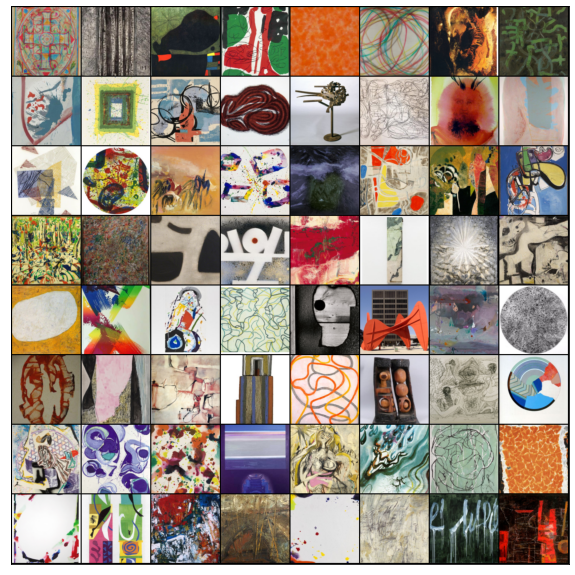

In [43]:
def show_images(images,nmax=64):
  fig,ax=plt.subplots(figsize=(10,12))
  ax.set_xticks([])
  ax.set_yticks([])
  ax.imshow(make_grid(denorm(images.detach()[:nmax]),n_row=8).permute(1,2,0))

def show_batch(dl,nmax=64):
  for images,_ in dl:
    show_images(images,nmax)
    break

show_batch(train_dl,nmax=64)

In [44]:

def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [45]:
device=get_default_device()
train_dl=DeviceDataLoader(train_dl,device)
device

device(type='cuda')

In [46]:
latent_size=128
import torch.nn as nn

# **Generator**

In [47]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1
    nn.ConvTranspose2d(latent_size, 1024, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(1024),
    nn.ReLU(True),
    # 1024 x 4 x 4

    nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 8 x 8

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 16 x 16

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 32 x 32

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 64 x 64 x 64

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 128 x 128
)

torch.Size([128, 3, 128, 128])


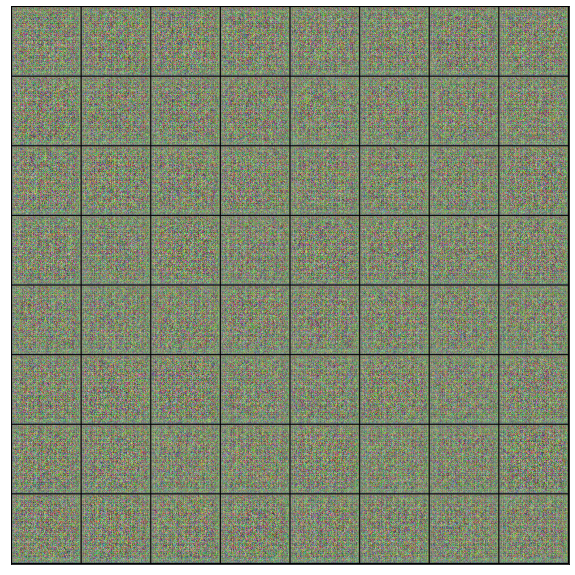

In [48]:
xb=torch.randn(batch_size,latent_size,1,1)
fake_images=generator(xb)
print(fake_images.shape)
show_images(fake_images)

In [49]:
discriminator = nn.Sequential(
    # in: 3 x 128 x 128

    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 64 x 64

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 32 x 32

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 16 x 16

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 8 x 8

    nn.Conv2d(512, 1024, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(1024),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 1024 x 4 x 4

    nn.Conv2d(1024, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())

In [50]:
generator=to_device(generator,device)
discriminator= to_device(discriminator,device)

In [51]:
generator

Sequential(
  (0): ConvTranspose2d(128, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (5): ReLU(inplace=True)
  (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (8): ReLU(inplace=True)
  (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): ReLU(inplace=True)
  (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (13): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, t

In [52]:
discriminator

Sequential(
  (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): LeakyReLU(negative_slope=0.2, inplace=True)
  (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (5): LeakyReLU(negative_slope=0.2, inplace=True)
  (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (8): LeakyReLU(negative_slope=0.2, inplace=True)
  (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): LeakyReLU(negative_slope=0.2, inplace=True)
  (12): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False

In [53]:
import torch.nn.functional as F

In [54]:
def train_discriminator(real_images, opt_d):
    # Clear discriminator gradients
    opt_d.zero_grad()

    # Pass real images through discriminator
    real_preds = discriminator(real_images)
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Pass fake images through discriminator
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score

In [55]:
def train_generator(opt_g):
    # Clear generator gradients
    opt_g.zero_grad()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)
    
    # Try to fool the discriminator
    preds = discriminator(fake_images)
    targets = torch.ones(batch_size, 1, device=device)
    loss = F.binary_cross_entropy(preds, targets)
    
    # Update generator weights
    loss.backward()
    opt_g.step()
    
    return loss.item()

In [56]:
from torchvision.utils import save_image

In [57]:
sample_dir='generated_images'
os.makedirs(sample_dir,exist_ok=True)

In [58]:
def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))

Saving generated-images-0000.png


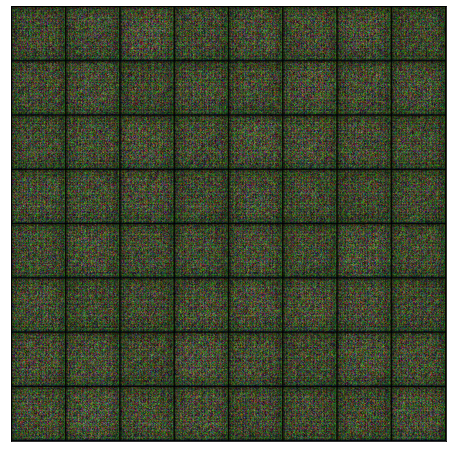

In [59]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)
save_samples(0, fixed_latent)

In [60]:
from tqdm.notebook import tqdm

In [61]:
def fit(epochs, lr_d,lr_g,start_idx=1):
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr_d, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr_g, betas=(0.5, 0.999))
    
    for epoch in range(epochs):
        for real_images, _ in tqdm(train_dl):
            # Train discriminator
            loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
            # Train generator
            loss_g = train_generator(opt_g)
            
        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
    
        # Save generated images
        save_samples(epoch+start_idx, fixed_latent, show=False)
    
    return losses_g, losses_d, real_scores, fake_scores

In [62]:
lr_d=10e-5
lr_g=10e-4
epochs=200

In [63]:
%%time
history=fit(epochs,lr_d,lr_g)

  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [1/200], loss_g: 4.4820, loss_d: 1.2928, real_score: 0.5697, fake_score: 0.4841
Saving generated-images-0001.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [2/200], loss_g: 1.5943, loss_d: 1.5306, real_score: 0.4496, fake_score: 0.4892
Saving generated-images-0002.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [3/200], loss_g: 2.0076, loss_d: 1.7561, real_score: 0.5361, fake_score: 0.6546
Saving generated-images-0003.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [4/200], loss_g: 1.4712, loss_d: 1.1694, real_score: 0.5268, fake_score: 0.3794
Saving generated-images-0004.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [5/200], loss_g: 1.0599, loss_d: 1.3317, real_score: 0.5173, fake_score: 0.4285
Saving generated-images-0005.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [6/200], loss_g: 1.5902, loss_d: 1.1621, real_score: 0.5542, fake_score: 0.3644
Saving generated-images-0006.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [7/200], loss_g: 2.1054, loss_d: 1.0638, real_score: 0.7460, fake_score: 0.5181
Saving generated-images-0007.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [8/200], loss_g: 0.9878, loss_d: 1.2931, real_score: 0.5500, fake_score: 0.4536
Saving generated-images-0008.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [9/200], loss_g: 0.9793, loss_d: 1.3565, real_score: 0.5690, fake_score: 0.5105
Saving generated-images-0009.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [10/200], loss_g: 1.2559, loss_d: 1.2045, real_score: 0.5620, fake_score: 0.4408
Saving generated-images-0010.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [11/200], loss_g: 1.2378, loss_d: 1.2311, real_score: 0.5297, fake_score: 0.4008
Saving generated-images-0011.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [12/200], loss_g: 2.2008, loss_d: 1.0772, real_score: 0.6891, fake_score: 0.4661
Saving generated-images-0012.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [13/200], loss_g: 1.9296, loss_d: 0.9776, real_score: 0.5699, fake_score: 0.2813
Saving generated-images-0013.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [14/200], loss_g: 1.4007, loss_d: 1.0393, real_score: 0.5889, fake_score: 0.3421
Saving generated-images-0014.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [15/200], loss_g: 3.1439, loss_d: 1.7136, real_score: 0.8045, fake_score: 0.7538
Saving generated-images-0015.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [16/200], loss_g: 2.4403, loss_d: 1.3147, real_score: 0.7509, fake_score: 0.6196
Saving generated-images-0016.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [17/200], loss_g: 1.3608, loss_d: 1.2074, real_score: 0.4973, fake_score: 0.3497
Saving generated-images-0017.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [18/200], loss_g: 1.5935, loss_d: 1.4003, real_score: 0.4602, fake_score: 0.3732
Saving generated-images-0018.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [19/200], loss_g: 1.8300, loss_d: 0.8378, real_score: 0.6263, fake_score: 0.2756
Saving generated-images-0019.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [20/200], loss_g: 2.3015, loss_d: 1.1088, real_score: 0.7143, fake_score: 0.5214
Saving generated-images-0020.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [21/200], loss_g: 2.1617, loss_d: 0.9102, real_score: 0.5862, fake_score: 0.2695
Saving generated-images-0021.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [22/200], loss_g: 2.4019, loss_d: 0.5716, real_score: 0.7035, fake_score: 0.1832
Saving generated-images-0022.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [23/200], loss_g: 3.0708, loss_d: 0.6837, real_score: 0.7218, fake_score: 0.2774
Saving generated-images-0023.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [24/200], loss_g: 1.1762, loss_d: 1.4378, real_score: 0.3587, fake_score: 0.2585
Saving generated-images-0024.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [25/200], loss_g: 1.8664, loss_d: 0.8179, real_score: 0.5873, fake_score: 0.2107
Saving generated-images-0025.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [26/200], loss_g: 2.0123, loss_d: 1.1424, real_score: 0.5921, fake_score: 0.4046
Saving generated-images-0026.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [27/200], loss_g: 1.3616, loss_d: 1.2357, real_score: 0.3736, fake_score: 0.1229
Saving generated-images-0027.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [28/200], loss_g: 2.6916, loss_d: 0.7625, real_score: 0.6016, fake_score: 0.1996
Saving generated-images-0028.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [29/200], loss_g: 6.0481, loss_d: 0.2213, real_score: 0.9485, fake_score: 0.1510
Saving generated-images-0029.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [30/200], loss_g: 4.5581, loss_d: 0.8883, real_score: 0.9398, fake_score: 0.5319
Saving generated-images-0030.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [31/200], loss_g: 2.8336, loss_d: 0.8584, real_score: 0.6766, fake_score: 0.3216
Saving generated-images-0031.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [32/200], loss_g: 2.1504, loss_d: 3.0225, real_score: 0.0696, fake_score: 0.0100
Saving generated-images-0032.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [33/200], loss_g: 1.8553, loss_d: 1.2654, real_score: 0.5687, fake_score: 0.4370
Saving generated-images-0033.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [34/200], loss_g: 2.0047, loss_d: 0.8677, real_score: 0.6252, fake_score: 0.2852
Saving generated-images-0034.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [35/200], loss_g: 1.7962, loss_d: 1.0979, real_score: 0.5511, fake_score: 0.3388
Saving generated-images-0035.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [36/200], loss_g: 2.4762, loss_d: 1.2359, real_score: 0.6431, fake_score: 0.5016
Saving generated-images-0036.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [37/200], loss_g: 4.4076, loss_d: 0.8589, real_score: 0.8371, fake_score: 0.4344
Saving generated-images-0037.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [38/200], loss_g: 2.7004, loss_d: 0.9951, real_score: 0.6747, fake_score: 0.4131
Saving generated-images-0038.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [39/200], loss_g: 2.8347, loss_d: 0.6427, real_score: 0.8122, fake_score: 0.3244
Saving generated-images-0039.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [40/200], loss_g: 1.6106, loss_d: 0.8061, real_score: 0.5857, fake_score: 0.1852
Saving generated-images-0040.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [41/200], loss_g: 4.8380, loss_d: 1.8699, real_score: 0.9233, fake_score: 0.7946
Saving generated-images-0041.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [42/200], loss_g: 2.8958, loss_d: 0.4132, real_score: 0.8180, fake_score: 0.1739
Saving generated-images-0042.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [43/200], loss_g: 1.1453, loss_d: 1.2965, real_score: 0.4051, fake_score: 0.1560
Saving generated-images-0043.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [44/200], loss_g: 3.6077, loss_d: 1.4322, real_score: 0.8509, fake_score: 0.6559
Saving generated-images-0044.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [45/200], loss_g: 2.5253, loss_d: 0.8265, real_score: 0.6304, fake_score: 0.2492
Saving generated-images-0045.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [46/200], loss_g: 2.5468, loss_d: 0.9884, real_score: 0.5884, fake_score: 0.2892
Saving generated-images-0046.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [47/200], loss_g: 1.5242, loss_d: 0.8941, real_score: 0.5435, fake_score: 0.1745
Saving generated-images-0047.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [48/200], loss_g: 1.5709, loss_d: 1.5747, real_score: 0.2827, fake_score: 0.0907
Saving generated-images-0048.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [49/200], loss_g: 2.3281, loss_d: 0.7382, real_score: 0.7317, fake_score: 0.3163
Saving generated-images-0049.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [50/200], loss_g: 3.0633, loss_d: 1.1045, real_score: 0.7037, fake_score: 0.4817
Saving generated-images-0050.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [51/200], loss_g: 2.5027, loss_d: 1.1816, real_score: 0.7194, fake_score: 0.5237
Saving generated-images-0051.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [52/200], loss_g: 2.6474, loss_d: 1.3666, real_score: 0.7260, fake_score: 0.6049
Saving generated-images-0052.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [53/200], loss_g: 2.3404, loss_d: 1.0374, real_score: 0.7415, fake_score: 0.4904
Saving generated-images-0053.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [54/200], loss_g: 1.5482, loss_d: 1.1817, real_score: 0.5122, fake_score: 0.3469
Saving generated-images-0054.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [55/200], loss_g: 1.5394, loss_d: 1.3404, real_score: 0.4874, fake_score: 0.3838
Saving generated-images-0055.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [56/200], loss_g: 2.3101, loss_d: 1.3749, real_score: 0.7012, fake_score: 0.6077
Saving generated-images-0056.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [57/200], loss_g: 1.8345, loss_d: 1.2517, real_score: 0.5937, fake_score: 0.4838
Saving generated-images-0057.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [58/200], loss_g: 1.2952, loss_d: 1.2647, real_score: 0.4988, fake_score: 0.3943
Saving generated-images-0058.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [59/200], loss_g: 1.9236, loss_d: 1.0888, real_score: 0.6663, fake_score: 0.4616
Saving generated-images-0059.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [60/200], loss_g: 1.5468, loss_d: 1.2086, real_score: 0.5007, fake_score: 0.3549
Saving generated-images-0060.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [61/200], loss_g: 1.3597, loss_d: 1.2769, real_score: 0.4914, fake_score: 0.3807
Saving generated-images-0061.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [62/200], loss_g: 1.9511, loss_d: 1.0726, real_score: 0.5877, fake_score: 0.3783
Saving generated-images-0062.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [63/200], loss_g: 2.3416, loss_d: 1.0538, real_score: 0.6404, fake_score: 0.4187
Saving generated-images-0063.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [64/200], loss_g: 2.0898, loss_d: 1.0336, real_score: 0.5252, fake_score: 0.2422
Saving generated-images-0064.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [65/200], loss_g: 2.0029, loss_d: 0.9470, real_score: 0.5422, fake_score: 0.2217
Saving generated-images-0065.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [66/200], loss_g: 1.7751, loss_d: 1.5116, real_score: 0.4379, fake_score: 0.4222
Saving generated-images-0066.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [67/200], loss_g: 1.8711, loss_d: 0.9772, real_score: 0.6072, fake_score: 0.3180
Saving generated-images-0067.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [68/200], loss_g: 2.2455, loss_d: 1.0341, real_score: 0.5978, fake_score: 0.3595
Saving generated-images-0068.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [69/200], loss_g: 2.3084, loss_d: 1.1897, real_score: 0.6967, fake_score: 0.5286
Saving generated-images-0069.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [70/200], loss_g: 2.0947, loss_d: 1.0414, real_score: 0.5611, fake_score: 0.3341
Saving generated-images-0070.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [71/200], loss_g: 0.9447, loss_d: 1.4071, real_score: 0.3607, fake_score: 0.2228
Saving generated-images-0071.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [72/200], loss_g: 2.2528, loss_d: 1.4063, real_score: 0.5831, fake_score: 0.5100
Saving generated-images-0072.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [73/200], loss_g: 2.6338, loss_d: 1.2607, real_score: 0.7128, fake_score: 0.5563
Saving generated-images-0073.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [74/200], loss_g: 1.6108, loss_d: 1.4402, real_score: 0.4770, fake_score: 0.4207
Saving generated-images-0074.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [75/200], loss_g: 2.1687, loss_d: 0.7966, real_score: 0.7128, fake_score: 0.3360
Saving generated-images-0075.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [76/200], loss_g: 3.1359, loss_d: 1.3484, real_score: 0.8336, fake_score: 0.6431
Saving generated-images-0076.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [77/200], loss_g: 2.2540, loss_d: 1.2445, real_score: 0.5334, fake_score: 0.4078
Saving generated-images-0077.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [78/200], loss_g: 2.5517, loss_d: 0.9661, real_score: 0.6529, fake_score: 0.3688
Saving generated-images-0078.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [79/200], loss_g: 2.5875, loss_d: 1.0635, real_score: 0.6547, fake_score: 0.4208
Saving generated-images-0079.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [80/200], loss_g: 2.0185, loss_d: 1.0690, real_score: 0.5558, fake_score: 0.3170
Saving generated-images-0080.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [81/200], loss_g: 2.8028, loss_d: 0.8665, real_score: 0.7345, fake_score: 0.3865
Saving generated-images-0081.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [82/200], loss_g: 1.6008, loss_d: 0.9657, real_score: 0.5206, fake_score: 0.2079
Saving generated-images-0082.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [83/200], loss_g: 2.4194, loss_d: 0.9385, real_score: 0.6860, fake_score: 0.3790
Saving generated-images-0083.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [84/200], loss_g: 2.6904, loss_d: 1.0368, real_score: 0.7084, fake_score: 0.4434
Saving generated-images-0084.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [85/200], loss_g: 2.2169, loss_d: 1.1702, real_score: 0.6767, fake_score: 0.4933
Saving generated-images-0085.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [86/200], loss_g: 3.1627, loss_d: 0.9763, real_score: 0.7189, fake_score: 0.4206
Saving generated-images-0086.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [87/200], loss_g: 3.6949, loss_d: 1.1993, real_score: 0.7186, fake_score: 0.5370
Saving generated-images-0087.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [88/200], loss_g: 1.0615, loss_d: 1.2694, real_score: 0.4430, fake_score: 0.2979
Saving generated-images-0088.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [89/200], loss_g: 3.1589, loss_d: 0.8081, real_score: 0.7374, fake_score: 0.3555
Saving generated-images-0089.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [90/200], loss_g: 1.5788, loss_d: 0.9263, real_score: 0.5117, fake_score: 0.1489
Saving generated-images-0090.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [91/200], loss_g: 2.8195, loss_d: 1.0780, real_score: 0.6363, fake_score: 0.4149
Saving generated-images-0091.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [92/200], loss_g: 1.5244, loss_d: 1.1603, real_score: 0.4260, fake_score: 0.1553
Saving generated-images-0092.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [93/200], loss_g: 1.7634, loss_d: 1.0579, real_score: 0.4958, fake_score: 0.2046
Saving generated-images-0093.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [94/200], loss_g: 2.5542, loss_d: 0.9115, real_score: 0.5959, fake_score: 0.2529
Saving generated-images-0094.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [95/200], loss_g: 4.1907, loss_d: 1.0351, real_score: 0.8134, fake_score: 0.5119
Saving generated-images-0095.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [96/200], loss_g: 3.2754, loss_d: 0.7382, real_score: 0.7257, fake_score: 0.3008
Saving generated-images-0096.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [97/200], loss_g: 2.2425, loss_d: 0.8744, real_score: 0.5880, fake_score: 0.2359
Saving generated-images-0097.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [98/200], loss_g: 3.1748, loss_d: 0.9478, real_score: 0.6415, fake_score: 0.3280
Saving generated-images-0098.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [99/200], loss_g: 3.4792, loss_d: 1.0963, real_score: 0.7521, fake_score: 0.4954
Saving generated-images-0099.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [100/200], loss_g: 1.9258, loss_d: 0.9318, real_score: 0.5108, fake_score: 0.1384
Saving generated-images-0100.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [101/200], loss_g: 3.6078, loss_d: 1.0011, real_score: 0.7293, fake_score: 0.4398
Saving generated-images-0101.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [102/200], loss_g: 2.2746, loss_d: 0.8940, real_score: 0.5130, fake_score: 0.1040
Saving generated-images-0102.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [103/200], loss_g: 3.6549, loss_d: 0.9513, real_score: 0.7137, fake_score: 0.4045
Saving generated-images-0103.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [104/200], loss_g: 3.2729, loss_d: 1.0155, real_score: 0.8380, fake_score: 0.5220
Saving generated-images-0104.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [105/200], loss_g: 2.2587, loss_d: 0.8720, real_score: 0.5303, fake_score: 0.1292
Saving generated-images-0105.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [106/200], loss_g: 3.5806, loss_d: 0.8049, real_score: 0.8144, fake_score: 0.3977
Saving generated-images-0106.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [107/200], loss_g: 2.4654, loss_d: 0.9455, real_score: 0.5784, fake_score: 0.2665
Saving generated-images-0107.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [108/200], loss_g: 2.2864, loss_d: 0.7778, real_score: 0.5823, fake_score: 0.1259
Saving generated-images-0108.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [109/200], loss_g: 2.1491, loss_d: 0.8753, real_score: 0.5341, fake_score: 0.1447
Saving generated-images-0109.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [110/200], loss_g: 2.2933, loss_d: 0.8393, real_score: 0.6139, fake_score: 0.2366
Saving generated-images-0110.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [111/200], loss_g: 3.4455, loss_d: 0.7226, real_score: 0.7954, fake_score: 0.3388
Saving generated-images-0111.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [112/200], loss_g: 3.2625, loss_d: 0.9115, real_score: 0.7287, fake_score: 0.3779
Saving generated-images-0112.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [113/200], loss_g: 3.9640, loss_d: 0.9597, real_score: 0.8300, fake_score: 0.4694
Saving generated-images-0113.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [114/200], loss_g: 2.7154, loss_d: 0.7262, real_score: 0.7739, fake_score: 0.3217
Saving generated-images-0114.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [115/200], loss_g: 3.8518, loss_d: 0.8047, real_score: 0.7756, fake_score: 0.3619
Saving generated-images-0115.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [116/200], loss_g: 3.1175, loss_d: 0.7748, real_score: 0.7028, fake_score: 0.2931
Saving generated-images-0116.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [117/200], loss_g: 4.3950, loss_d: 0.8898, real_score: 0.8247, fake_score: 0.4459
Saving generated-images-0117.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [118/200], loss_g: 3.2998, loss_d: 0.8286, real_score: 0.7408, fake_score: 0.3488
Saving generated-images-0118.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [119/200], loss_g: 2.4281, loss_d: 0.7065, real_score: 0.7030, fake_score: 0.2330
Saving generated-images-0119.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [120/200], loss_g: 1.8693, loss_d: 0.8517, real_score: 0.5714, fake_score: 0.1702
Saving generated-images-0120.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [121/200], loss_g: 3.1452, loss_d: 0.6721, real_score: 0.7833, fake_score: 0.2923
Saving generated-images-0121.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [122/200], loss_g: 3.7854, loss_d: 0.5517, real_score: 0.8544, fake_score: 0.2910
Saving generated-images-0122.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [123/200], loss_g: 3.6275, loss_d: 0.5790, real_score: 0.8699, fake_score: 0.3106
Saving generated-images-0123.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [124/200], loss_g: 4.2718, loss_d: 0.6173, real_score: 0.8573, fake_score: 0.3268
Saving generated-images-0124.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [125/200], loss_g: 3.2029, loss_d: 0.7046, real_score: 0.6962, fake_score: 0.2090
Saving generated-images-0125.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [126/200], loss_g: 3.0427, loss_d: 0.7272, real_score: 0.8991, fake_score: 0.3907
Saving generated-images-0126.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [127/200], loss_g: 3.1225, loss_d: 0.7062, real_score: 0.7050, fake_score: 0.2377
Saving generated-images-0127.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [128/200], loss_g: 3.9247, loss_d: 0.4588, real_score: 0.8503, fake_score: 0.2213
Saving generated-images-0128.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [129/200], loss_g: 4.7277, loss_d: 0.7648, real_score: 0.8779, fake_score: 0.4140
Saving generated-images-0129.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [130/200], loss_g: 3.5303, loss_d: 0.5159, real_score: 0.8483, fake_score: 0.2553
Saving generated-images-0130.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [131/200], loss_g: 4.4598, loss_d: 0.5634, real_score: 0.8218, fake_score: 0.2570
Saving generated-images-0131.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [132/200], loss_g: 4.2101, loss_d: 0.6376, real_score: 0.8380, fake_score: 0.3197
Saving generated-images-0132.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [133/200], loss_g: 3.6902, loss_d: 0.3858, real_score: 0.8225, fake_score: 0.1464
Saving generated-images-0133.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [134/200], loss_g: 3.4315, loss_d: 0.9416, real_score: 0.4916, fake_score: 0.0308
Saving generated-images-0134.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [135/200], loss_g: 3.8488, loss_d: 0.3838, real_score: 0.7963, fake_score: 0.1122
Saving generated-images-0135.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [136/200], loss_g: 2.5734, loss_d: 0.6432, real_score: 0.7235, fake_score: 0.1977
Saving generated-images-0136.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [137/200], loss_g: 3.6048, loss_d: 0.4534, real_score: 0.9086, fake_score: 0.2670
Saving generated-images-0137.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [138/200], loss_g: 3.9491, loss_d: 0.4416, real_score: 0.8821, fake_score: 0.2214
Saving generated-images-0138.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [139/200], loss_g: 4.5674, loss_d: 0.3066, real_score: 0.8820, fake_score: 0.1413
Saving generated-images-0139.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [140/200], loss_g: 3.5425, loss_d: 0.3429, real_score: 0.8296, fake_score: 0.1160
Saving generated-images-0140.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [141/200], loss_g: 3.3625, loss_d: 0.4291, real_score: 0.8048, fake_score: 0.1452
Saving generated-images-0141.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [142/200], loss_g: 2.8729, loss_d: 0.4205, real_score: 0.7597, fake_score: 0.1011
Saving generated-images-0142.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [143/200], loss_g: 4.1140, loss_d: 0.3641, real_score: 0.8036, fake_score: 0.0995
Saving generated-images-0143.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [144/200], loss_g: 3.1177, loss_d: 0.4728, real_score: 0.7429, fake_score: 0.1117
Saving generated-images-0144.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [145/200], loss_g: 3.3048, loss_d: 0.6611, real_score: 0.6011, fake_score: 0.0351
Saving generated-images-0145.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [146/200], loss_g: 4.5197, loss_d: 0.3677, real_score: 0.8595, fake_score: 0.1560
Saving generated-images-0146.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [147/200], loss_g: 4.8342, loss_d: 0.4808, real_score: 0.9037, fake_score: 0.2608
Saving generated-images-0147.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [148/200], loss_g: 4.2452, loss_d: 0.4112, real_score: 0.8550, fake_score: 0.1878
Saving generated-images-0148.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [149/200], loss_g: 4.8821, loss_d: 0.4517, real_score: 0.8955, fake_score: 0.2386
Saving generated-images-0149.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [150/200], loss_g: 4.6908, loss_d: 0.3892, real_score: 0.9110, fake_score: 0.2225
Saving generated-images-0150.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [151/200], loss_g: 3.3665, loss_d: 0.3838, real_score: 0.7835, fake_score: 0.0940
Saving generated-images-0151.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [152/200], loss_g: 5.1695, loss_d: 0.6819, real_score: 0.9571, fake_score: 0.4048
Saving generated-images-0152.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [153/200], loss_g: 2.8455, loss_d: 0.4208, real_score: 0.7501, fake_score: 0.0861
Saving generated-images-0153.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [154/200], loss_g: 4.0861, loss_d: 0.3923, real_score: 0.8549, fake_score: 0.1644
Saving generated-images-0154.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [155/200], loss_g: 2.7146, loss_d: 0.5847, real_score: 0.6268, fake_score: 0.0248
Saving generated-images-0155.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [156/200], loss_g: 4.6483, loss_d: 0.4970, real_score: 0.7135, fake_score: 0.0395
Saving generated-images-0156.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [157/200], loss_g: 5.8869, loss_d: 0.5672, real_score: 0.8785, fake_score: 0.3039
Saving generated-images-0157.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [158/200], loss_g: 4.9892, loss_d: 0.3004, real_score: 0.8737, fake_score: 0.1288
Saving generated-images-0158.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [159/200], loss_g: 4.4023, loss_d: 0.2756, real_score: 0.8932, fake_score: 0.1309
Saving generated-images-0159.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [160/200], loss_g: 5.9304, loss_d: 0.2888, real_score: 0.9199, fake_score: 0.1577
Saving generated-images-0160.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [161/200], loss_g: 6.6605, loss_d: 0.5837, real_score: 0.9794, fake_score: 0.3645
Saving generated-images-0161.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [162/200], loss_g: 3.2741, loss_d: 0.5424, real_score: 0.6600, fake_score: 0.0350
Saving generated-images-0162.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [163/200], loss_g: 4.3012, loss_d: 0.2418, real_score: 0.8547, fake_score: 0.0645
Saving generated-images-0163.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [164/200], loss_g: 4.4850, loss_d: 0.3182, real_score: 0.8817, fake_score: 0.1488
Saving generated-images-0164.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [165/200], loss_g: 3.5900, loss_d: 0.3147, real_score: 0.7935, fake_score: 0.0478
Saving generated-images-0165.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [166/200], loss_g: 5.8396, loss_d: 0.9843, real_score: 0.4700, fake_score: 0.0017
Saving generated-images-0166.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [167/200], loss_g: 5.1985, loss_d: 0.2426, real_score: 0.8637, fake_score: 0.0687
Saving generated-images-0167.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [168/200], loss_g: 4.1868, loss_d: 0.2990, real_score: 0.9163, fake_score: 0.1620
Saving generated-images-0168.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [169/200], loss_g: 4.7110, loss_d: 0.2334, real_score: 0.9503, fake_score: 0.1469
Saving generated-images-0169.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [170/200], loss_g: 5.1631, loss_d: 0.3339, real_score: 0.9203, fake_score: 0.1845
Saving generated-images-0170.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [171/200], loss_g: 3.7878, loss_d: 0.3423, real_score: 0.8216, fake_score: 0.1028
Saving generated-images-0171.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [172/200], loss_g: 5.0534, loss_d: 0.1917, real_score: 0.8965, fake_score: 0.0613
Saving generated-images-0172.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [173/200], loss_g: 5.4455, loss_d: 0.7652, real_score: 0.7638, fake_score: 0.2738
Saving generated-images-0173.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [174/200], loss_g: 4.5247, loss_d: 0.2164, real_score: 0.9132, fake_score: 0.0988
Saving generated-images-0174.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [175/200], loss_g: 4.8298, loss_d: 0.3149, real_score: 0.9289, fake_score: 0.1789
Saving generated-images-0175.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [176/200], loss_g: 6.4327, loss_d: 0.4050, real_score: 0.9430, fake_score: 0.2517
Saving generated-images-0176.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [177/200], loss_g: 4.8467, loss_d: 0.2108, real_score: 0.9072, fake_score: 0.0893
Saving generated-images-0177.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [178/200], loss_g: 4.7885, loss_d: 0.3277, real_score: 0.8182, fake_score: 0.0546
Saving generated-images-0178.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [179/200], loss_g: 2.4650, loss_d: 0.3767, real_score: 0.7596, fake_score: 0.0520
Saving generated-images-0179.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [180/200], loss_g: 7.5554, loss_d: 0.3983, real_score: 0.9820, fake_score: 0.2683
Saving generated-images-0180.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [181/200], loss_g: 5.4787, loss_d: 0.2055, real_score: 0.9324, fake_score: 0.1132
Saving generated-images-0181.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [182/200], loss_g: 4.9701, loss_d: 0.1152, real_score: 0.9406, fake_score: 0.0488
Saving generated-images-0182.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [183/200], loss_g: 6.2103, loss_d: 0.2162, real_score: 0.9401, fake_score: 0.1246
Saving generated-images-0183.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [184/200], loss_g: 4.6670, loss_d: 0.2316, real_score: 0.9039, fake_score: 0.1074
Saving generated-images-0184.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [185/200], loss_g: 9.8644, loss_d: 0.6323, real_score: 0.9831, fake_score: 0.3767
Saving generated-images-0185.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [186/200], loss_g: 7.1034, loss_d: 0.2785, real_score: 0.9682, fake_score: 0.1807
Saving generated-images-0186.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [187/200], loss_g: 4.6862, loss_d: 0.2199, real_score: 0.9077, fake_score: 0.1010
Saving generated-images-0187.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [188/200], loss_g: 4.2905, loss_d: 0.1878, real_score: 0.9069, fake_score: 0.0741
Saving generated-images-0188.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [189/200], loss_g: 5.1449, loss_d: 0.1729, real_score: 0.9011, fake_score: 0.0564
Saving generated-images-0189.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [190/200], loss_g: 4.9661, loss_d: 0.2008, real_score: 0.8423, fake_score: 0.0107
Saving generated-images-0190.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [191/200], loss_g: 3.9634, loss_d: 0.2142, real_score: 0.8531, fake_score: 0.0196
Saving generated-images-0191.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [192/200], loss_g: 6.5067, loss_d: 0.1920, real_score: 0.9830, fake_score: 0.1453
Saving generated-images-0192.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [193/200], loss_g: 4.4596, loss_d: 0.2160, real_score: 0.8759, fake_score: 0.0506
Saving generated-images-0193.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [194/200], loss_g: 5.9887, loss_d: 0.2120, real_score: 0.9631, fake_score: 0.1369
Saving generated-images-0194.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [195/200], loss_g: 5.3649, loss_d: 0.1312, real_score: 0.9506, fake_score: 0.0694
Saving generated-images-0195.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [196/200], loss_g: 5.9687, loss_d: 0.1162, real_score: 0.9807, fake_score: 0.0832
Saving generated-images-0196.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [197/200], loss_g: 3.9743, loss_d: 0.0782, real_score: 0.9487, fake_score: 0.0188
Saving generated-images-0197.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [198/200], loss_g: 5.0053, loss_d: 0.1714, real_score: 0.9004, fake_score: 0.0457
Saving generated-images-0198.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [199/200], loss_g: 5.2886, loss_d: 0.0843, real_score: 0.9716, fake_score: 0.0512
Saving generated-images-0199.png


  0%|          | 0/22 [00:00<?, ?it/s]

Epoch [200/200], loss_g: 7.4293, loss_d: 0.2459, real_score: 0.9665, fake_score: 0.1595
Saving generated-images-0200.png
CPU times: user 50min 29s, sys: 1min 10s, total: 51min 40s
Wall time: 1h 56min 16s


In [64]:
losses_g, losses_d, real_scores, fake_scores = history

In [65]:
# Save the model checkpoints 
torch.save(generator.state_dict(), 'G.pth')
torch.save(discriminator.state_dict(), 'D.pth')

In [66]:
from IPython.display import Image

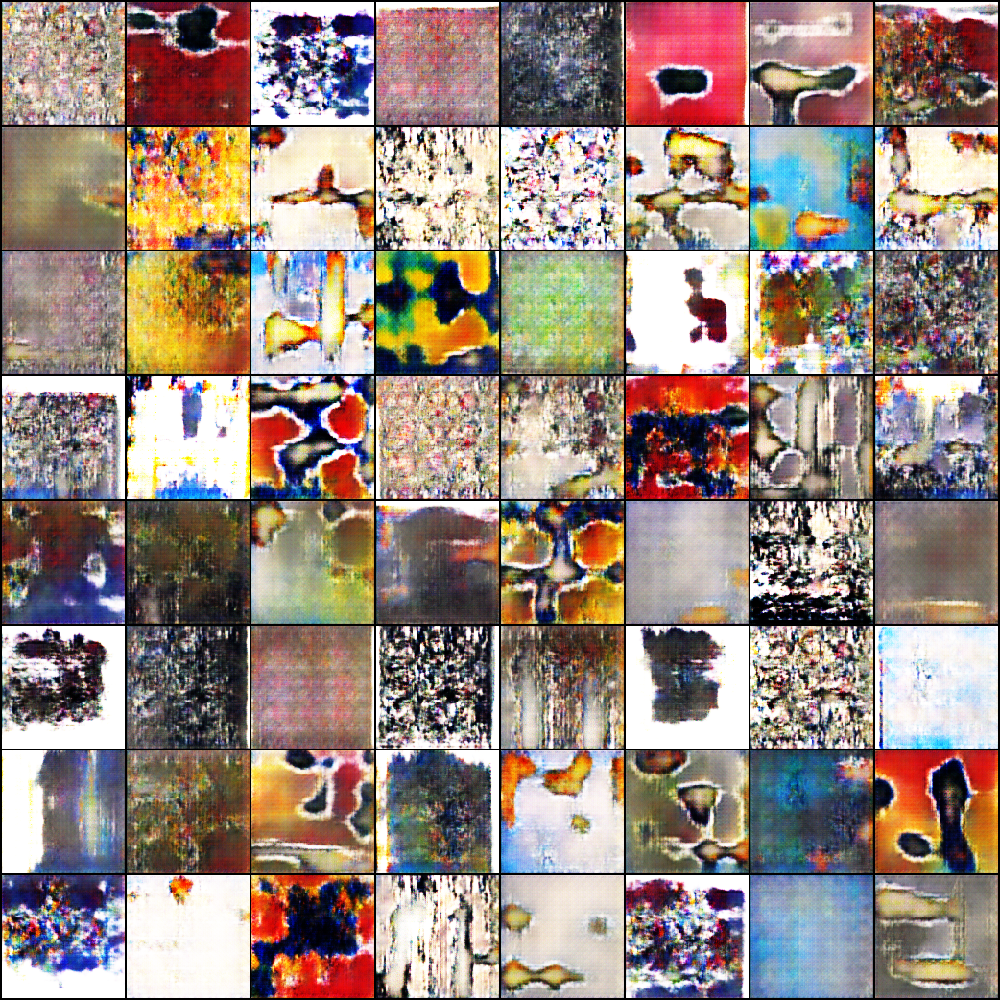

In [75]:
Image('./generated_images/generated-images-0135.png')

In [76]:
Image('./generated/generated-images-0150.png')

FileNotFoundError: ignored

FileNotFoundError: ignored

<IPython.core.display.Image object>

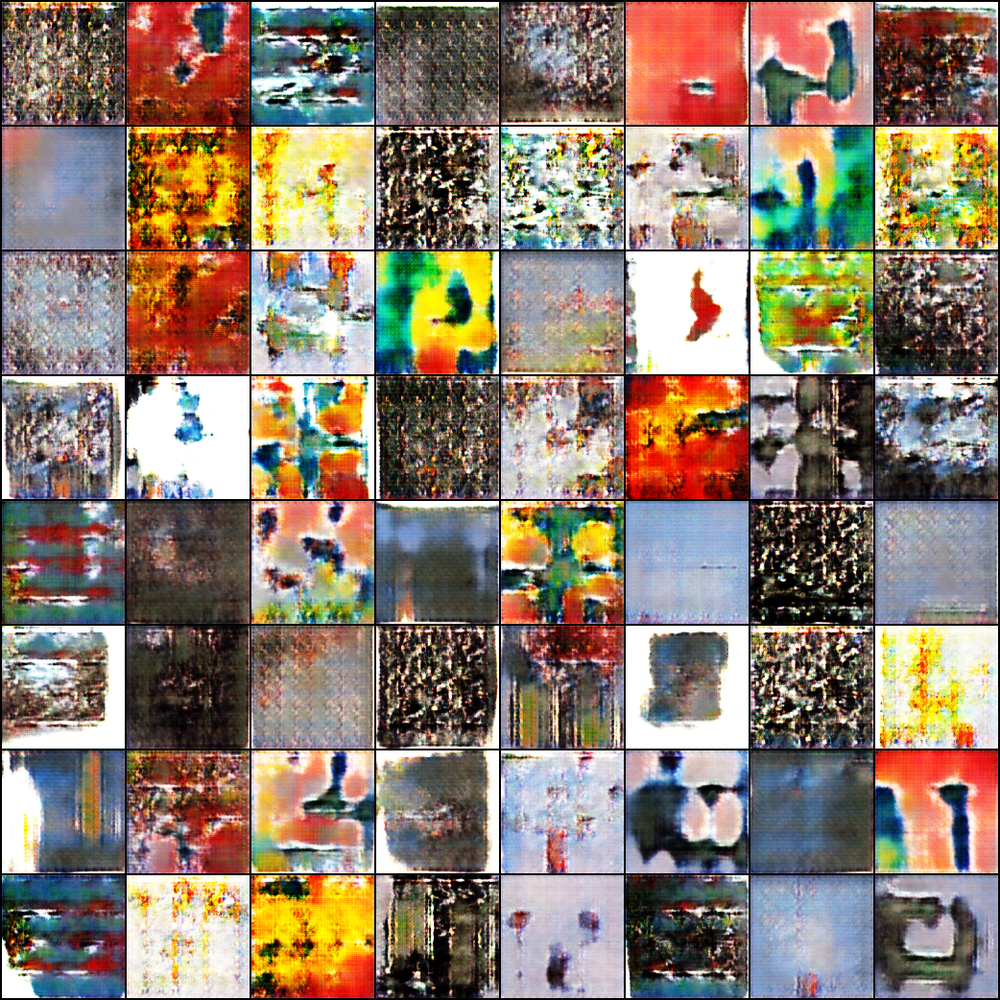

In [78]:
Image('./generated_images/generated-images-0120.png')

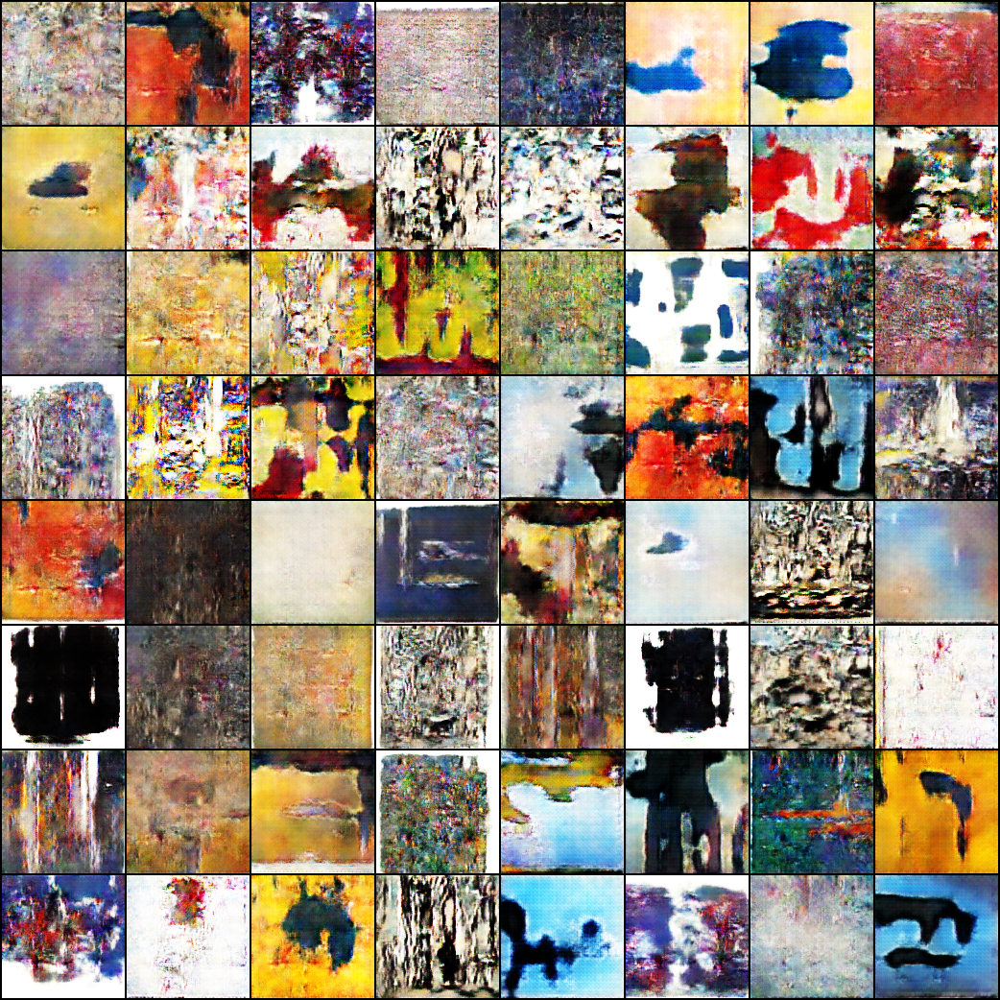

In [79]:
Image('./generated_images/generated-images-0190.png')

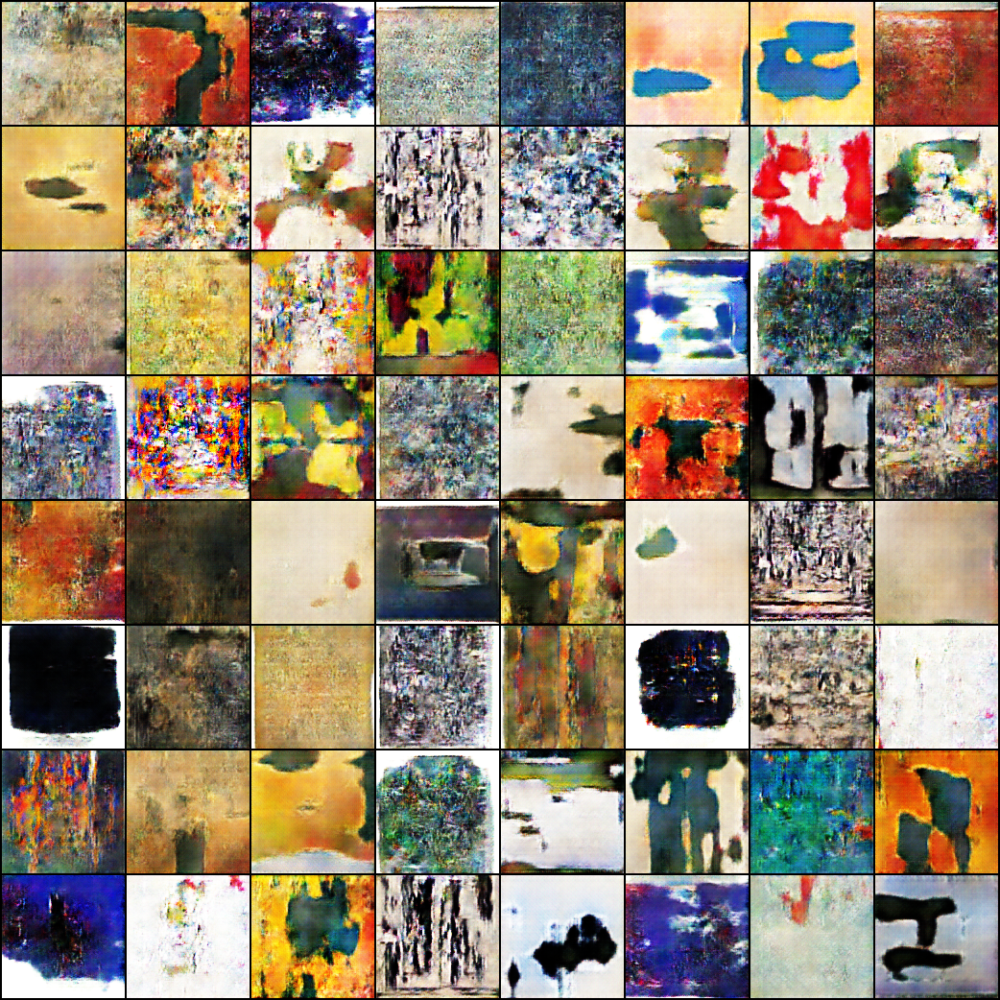

In [83]:
Image('./generated_images/generated-images-0200.png')

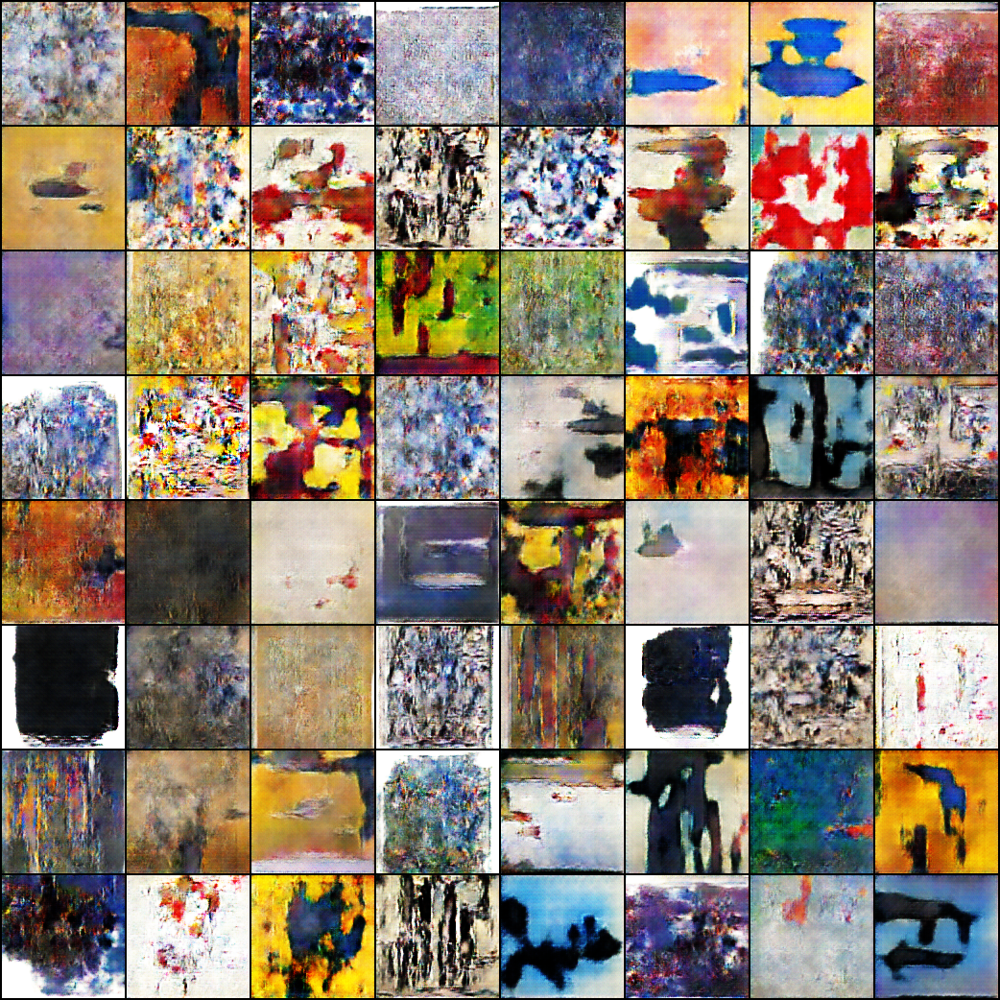

In [84]:
Image('./generated_images/generated-images-0195.png')

In [86]:
import cv2
import os
vid_fname= 'gans_training.avi'
files=[os.path.join(sample_dir,f) for f in os.listdir(sample_dir) if 'generated' in f]
files.sort()

out=cv2.VideoWriter(vid_fname,cv2.VideoWriter_fourcc(*'MP4V'),1,(1080,1080))
[out.write(cv2.imread(fname)) for fname in files]
out.release()

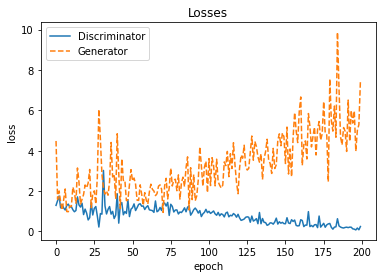

In [87]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '--')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');
     

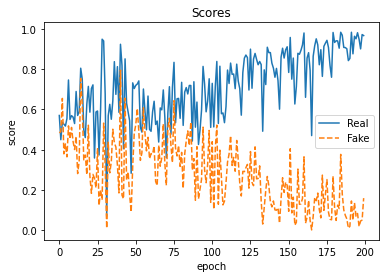

In [88]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '--')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');